In [1]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

In [ ]:
def crop_robust_count(image_path, debug=False):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None: return None
    
    h, w = img.shape
    
    # 1. Strefa analizy: ucinamy dół (podłogę), żeby nie psuła detekcji X
    # Ale ucinamy też górne 5 pikseli, żeby wywalić ten syf [106 106...] o którym wspomniałeś
    floor_cutoff = int(h * 0.85)
    ceiling_cutoff = 5 
    
    analysis_zone = img[ceiling_cutoff:floor_cutoff, :]
    
    # 2. PROGOWANIE AKTYWNOŚCI
    # Uznajemy, że wszystko poniżej 240 to "coś" (auto, cień, element).
    # Tło na twoim przykładzie to 245-249, więc 240 jest bezpieczne.
    # Tworzymy maskę zer i jedynek (1 tam gdzie jest coś ciemniejszego niż 240)
    binary_mask = (analysis_zone < 240).astype(np.uint8)
    
    # 3. ZLICZANIE W KOLUMNACH (Oś X)
    # Sumujemy, ile "punktów auta" jest w każdej kolumnie.
    # Pasek na górze (jeśli by został) dałby wynik 1. Auto da wynik np. 200.
    col_counts = np.sum(binary_mask, axis=0)
    
    # KRYTERIUM: Kolumna jest częścią auta, jeśli ma przynajmniej 30 "ciemnych" pikseli.
    # To eliminuje cienkie poziome linie (artefakty) i szum.
    valid_cols = np.where(col_counts > 30)[0]
    
    if len(valid_cols) == 0:
        print(f"Nie znaleziono auta (zbyt jasne lub pusty obraz): {image_path}")
        return img # Zwracamy oryginał

    x_min = valid_cols[0]
    x_max = valid_cols[-1]
    
    # 4. ZLICZANIE W WIERSZACH (Oś Y) - żeby znaleźć dach
    # Analizujemy tylko w zakresie wykrytej szerokości!
    row_counts = np.sum(binary_mask[:, x_min:x_max], axis=1)
    
    # Wiersz jest dachem, jeśli ma przynajmniej 30 pikseli szerokości obiektu
    valid_rows = np.where(row_counts > 30)[0]
    
    if len(valid_rows) == 0:
        y_min = 0
    else:
        # Dodajemy z powrotem ceiling_cutoff, bo analysis_zone była ucięta od góry
        y_min = valid_rows[0] + ceiling_cutoff

    # Dół bierzemy cały
    y_max = h

    # 5. Marginesy (Padding)
    pad = 30
    x_min = max(0, x_min - pad)
    x_max = min(w, x_max + pad)
    y_min = max(0, y_min - pad)
    
    if debug:
        print(f"Zakres X: {x_min}-{x_max}, Dach Y: {y_min}")
        plt.figure(figsize=(10,5))
        plt.imshow(img[y_min:y_max, x_min:x_max], cmap='gray')
        plt.title("Debug Crop")
        plt.show()

    return img[y_min:y_max, x_min:x_max]

[[106 106 108 ... 106 106 106]
 [245 247 246 ... 249 244 247]
 [245 247 246 ... 248 244 247]
 ...
 [243 247 243 ... 198 199 201]
 [245 244 241 ... 219 218 220]
 [246 239 236 ... 249 249 249]]


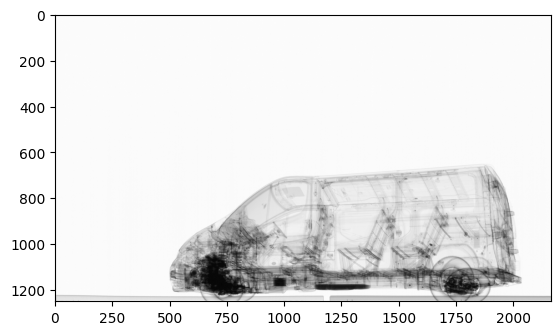

In [56]:
file_path = "czyste_przeksztalcone/48001F003202511180021 czarno.bmp"
file_path_2 = 'brudne_przeksztalcone/48001F003202511190119 czarno.bmp'
img = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
print(img)
plt.imshow(img, cmap='gray')

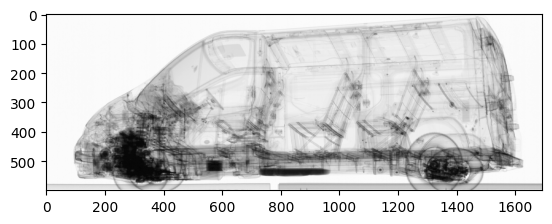

In [ ]:
processed = crop_robust_count(file_path)
# show image in matplotlib
processed
# plt.pyplot.imshow(processed, cmap='gray')
processed = np.array(processed)
plt.imshow(processed, cmap='gray')

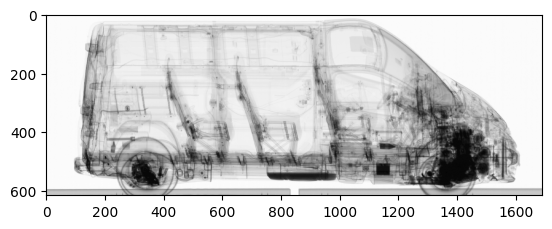

In [52]:
prcessed2 = crop_preserve_bottom(file_path_2)
prcessed2 = np.array(prcessed2)
plt.imshow(prcessed2, cmap='gray')

Znaleziono 128 zdjęć. Przetwarzanie...



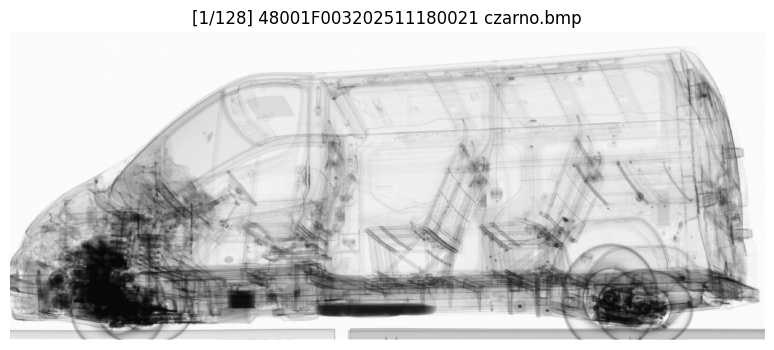

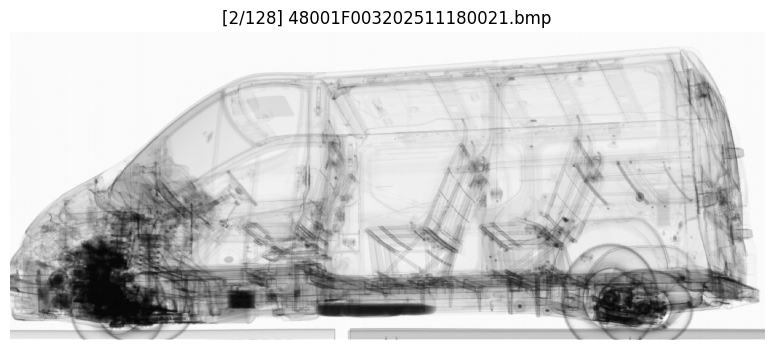

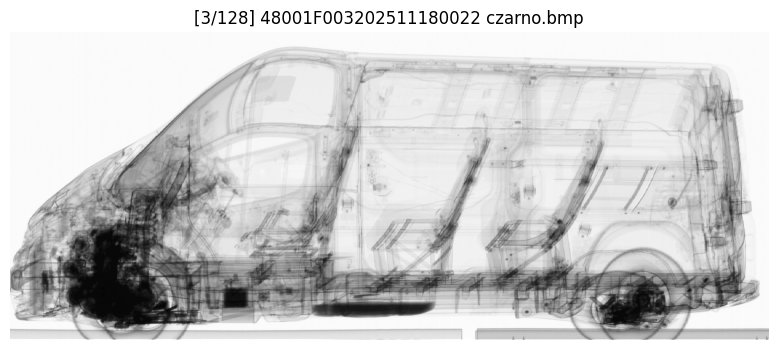

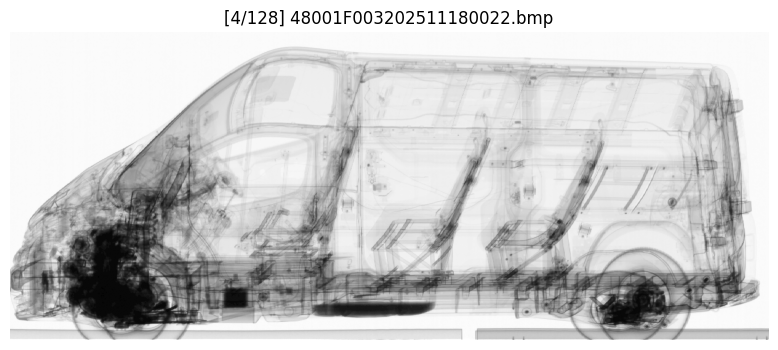

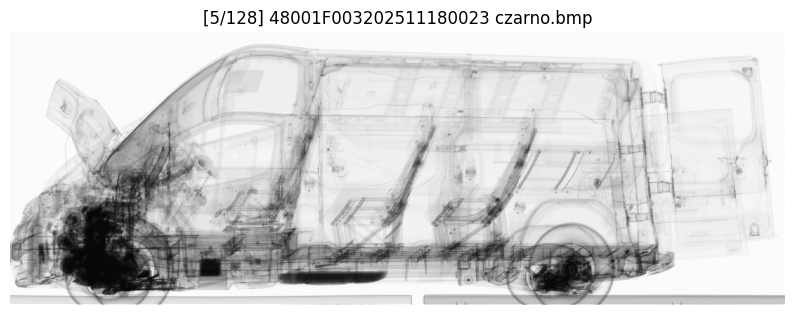

...

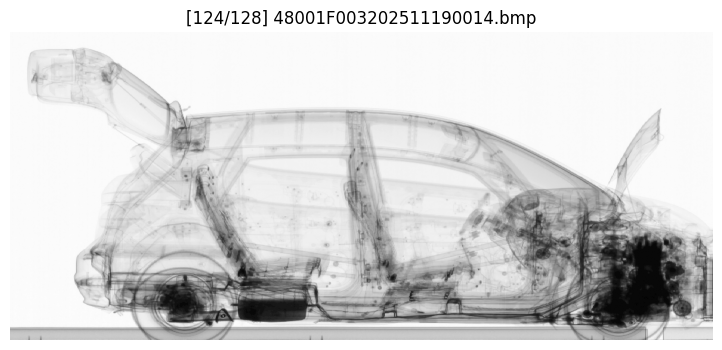

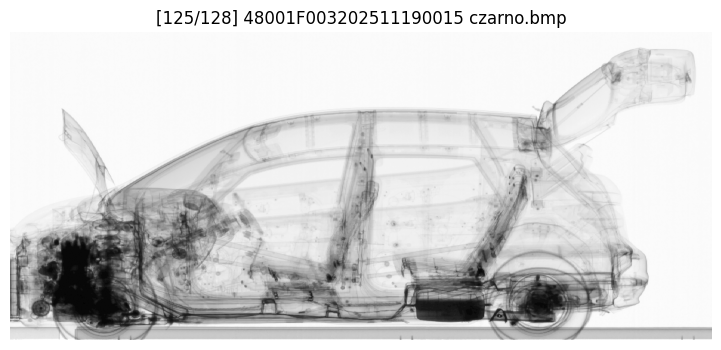

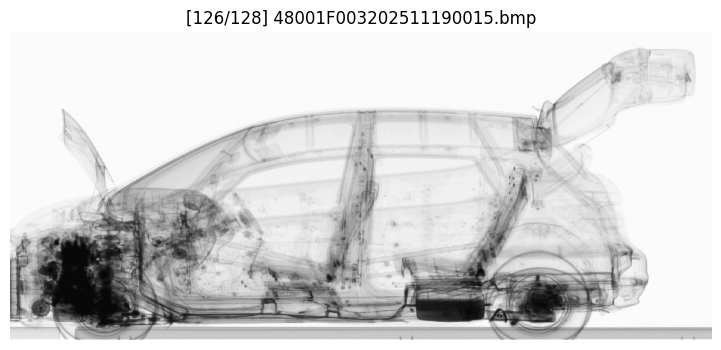

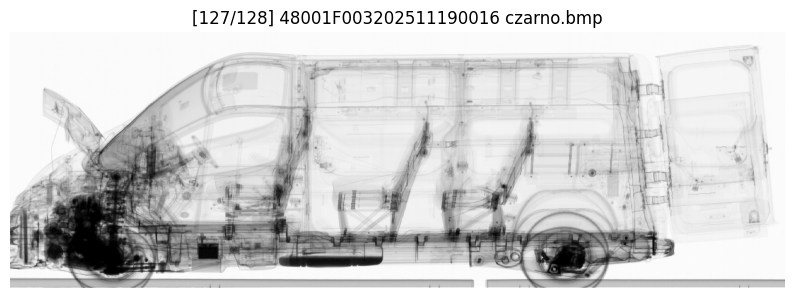

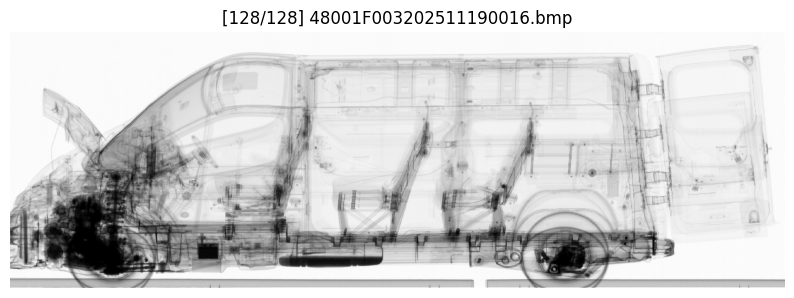

In [60]:
folder_path = 'czyste_przeksztalcone/'
if not os.path.exists(folder_path):
    print(f"Błąd: Folder '{folder_path}' nie istnieje.")
else:
    files = os.listdir(folder_path)
    # Filtrujemy tylko pliki graficzne
    image_files = [f for f in files if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))]
    
    print(f"Znaleziono {len(image_files)} zdjęć. Przetwarzanie...\n")

    for i, file_name in enumerate(image_files):
        full_path = os.path.join(folder_path, file_name)
        
        # Przetwarzanie
        result_img = crop_robust_count(full_path)
        
        # Wyświetlanie (Printowanie graficzne)
        plt.figure(figsize=(10, 4)) # Szeroki format, żeby było widać detale
        
        if result_img is not None:
            plt.imshow(result_img, cmap='gray')
            plt.title(f"[{i+1}/{len(image_files)}] {file_name}")
            plt.axis('off') # Ukryj osie X/Y dla czytelności
        else:
            plt.text(0.5, 0.5, "Błąd wczytania", ha='center')
            plt.title(f"{file_name} - BŁĄD")
            
        plt.show() # To wygeneruje obrazek pod obrazkiem w notebooku

In [75]:
def find_anomaly_in_dataset(dirty_path, clean_folder_path):
    print(f"--- ANALIZA OBRAZU: {os.path.basename(dirty_path)} ---")
    
    # A. Przygotowanie obrazu BRUDNEGO
    # Najpierw wycinamy auto, żeby nie analizować białego tła
    img_dirty_crop = crop_robust_count(dirty_path)
    if img_dirty_crop is None:
        print("Błąd: Nie udało się wykryć auta na zdjęciu badanym.")
        return

    # Robimy miniaturkę wyciętego auta do szybkiego szukania w pętli
    # Używamy float32 dla dokładniejszych obliczeń różnic
    search_size = (128, 128)
    img_dirty_thumb = cv2.resize(img_dirty_crop, search_size).astype("float32")

    # B. PĘTLA WYSZUKIWANIA (Szukamy bliźniaka w folderze czystych)
    clean_files = [f for f in os.listdir(clean_folder_path) if f.lower().endswith(('.bmp', '.jpg', '.png'))]
    
    if not clean_files:
        print("Błąd: Pusty folder ze zdjęciami wzorcowymi.")
        return

    best_score = float('inf')
    best_clean_crop = None
    best_filename = ""
    
    print(f"Przeszukiwanie bazy {len(clean_files)} zdjęć wzorcowych...")

    for f in clean_files:
        path = os.path.join(clean_folder_path, f)
        
        # 1. Wycinamy auto ze zdjęcia czystego
        # TO JEST KLUCZOWE: Porównujemy same auta, a nie to gdzie stoją na tle!
        clean_crop = crop_robust_count(path)
        
        if clean_crop is None:
            continue
            
        # 2. Skalujemy wycinek do miniaturki
        clean_thumb = cv2.resize(clean_crop, search_size).astype("float32")
        
        # 3. Porównujemy (MSE - Błąd średniokwadratowy)
        score = np.mean((img_dirty_thumb - clean_thumb) ** 2)
        
        if score < best_score:
            best_score = score
            best_clean_crop = clean_crop # Zapisujemy sobie pełny, wycięty obraz
            best_filename = f

    print(f"ZNALEZIONO BLIŹNIAKA: {best_filename} (Błąd dopasowania: {best_score:.2f})")

    if best_clean_crop is None:
        print("Nie znaleziono pasującego obrazu wzorcowego.")
        return

    # C. PROCESOWANIE RÓŻNIC (Logika wykrywania anomalii)
    
    # 1. Dopasowanie wymiarów
    # Skalujemy WYCIĘTEGO bliźniaka do wymiarów WYCIĘTEGO brudnego auta.
    # Dzięki temu nakładamy na siebie "maska na maskę, koło na koło".
    h_target, w_target = img_dirty_crop.shape
    img_clean_resized = cv2.resize(best_clean_crop, (w_target, h_target))

    # 2. Rozmycie (Usuwanie ziarna matrycy)
    k_blur = 5
    dirty_blur = cv2.GaussianBlur(img_dirty_crop, (k_blur, k_blur), 0)
    clean_blur = cv2.GaussianBlur(img_clean_resized, (k_blur, k_blur), 0)

    # 3. Odejmowanie (Wartość bezwzględna)
    diff = cv2.absdiff(dirty_blur, clean_blur)

    # 4. Progowanie (Threshold)
    # Wszystko co ma różnicę jasności mniejszą niż 45 uznajemy za zgodne.
    # Wyższe wartości (>45) to potencjalne anomalie.
    _, mask = cv2.threshold(diff, 45, 255, cv2.THRESH_BINARY)

    # 5. EROZJA (Usuwanie "duchów")
    # Cienkie linie powstałe przez minimalne przesunięcie auta znikną.
    kernel = np.ones((3, 3), np.uint8)
    mask_cleaned = cv2.erode(mask, kernel, iterations=2)
    
    # 6. DYLATACJA (Przywracanie kształtu)
    # Jeśli coś przetrwało erozję (duża plama), pompujemy to z powrotem.
    mask_final = cv2.dilate(mask_cleaned, kernel, iterations=4)

    # --- D. WIZUALIZACJA ---
    plt.figure(figsize=(16, 10))

    # Obraz 1: Co badamy?
    plt.subplot(2, 2, 1)
    plt.title("1. Badany (Wycinek)")
    plt.imshow(img_dirty_crop, cmap='gray')
    plt.axis('off')

    # Obraz 2: Z czym porównujemy?
    plt.subplot(2, 2, 2)
    plt.title(f"2. Wzorzec (Dopasowany): {best_filename}")
    plt.imshow(img_clean_resized, cmap='gray')
    plt.axis('off')

    # Obraz 3: Różnica surowa (dla Twojej informacji)
    plt.subplot(2, 2, 3)
    plt.title("3. Różnica surowa (widać szumy i przesunięcia)")
    plt.imshow(diff, cmap='gray')
    plt.axis('off')

    # Obraz 4: FINALNA DETEKCJA
    plt.subplot(2, 2, 4)
    plt.title("4. WYKRYTE ANOMALIE (Po filtracji)")
    plt.imshow(mask_final, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

--- ANALIZA OBRAZU: 48001F003202511190119 czarno.bmp ---
Przeszukiwanie bazy 128 zdjęć wzorcowych...
ZNALEZIONO BLIŹNIAKA: 48001F003202511180032 czarno.bmp (Błąd dopasowania: 326.62)


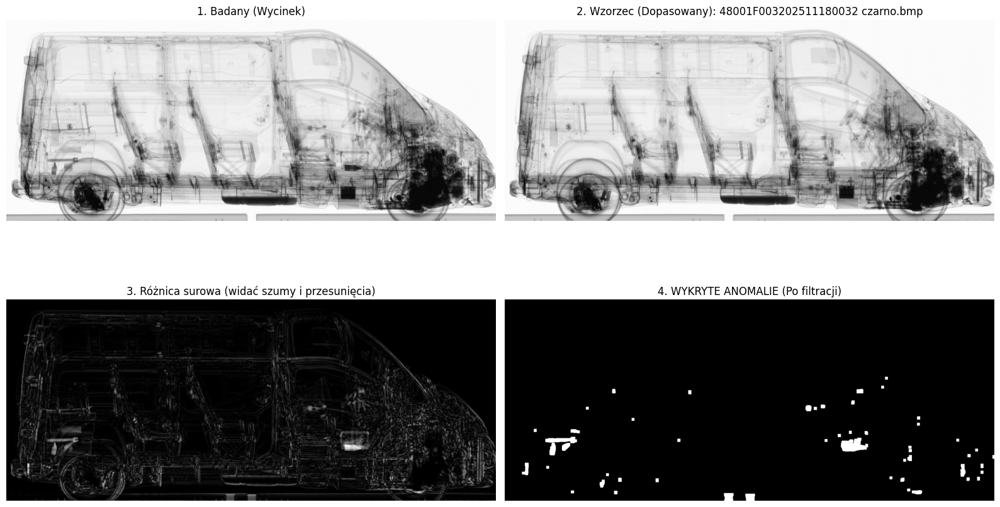

In [76]:
dirty_file = 'brudne_przeksztalcone/48001F003202511190119 czarno.bmp'

clean_folder = "czyste_przeksztalcone"

find_anomaly_in_dataset(dirty_file, clean_folder)

--- ANALIZA OBRAZU: 48001F003202511190040 czarno.bmp ---
Przeszukiwanie bazy 128 zdjęć wzorcowych...
ZNALEZIONO BLIŹNIAKA: 48001F003202511190008 czarno.bmp (Błąd dopasowania: 69.68)


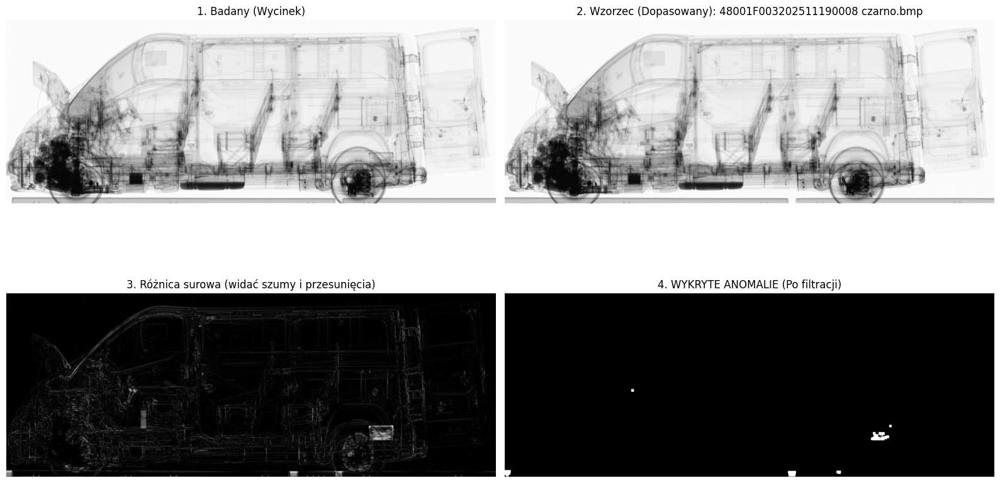

In [77]:
dirty_file = 'brudne_przeksztalcone/48001F003202511190040 czarno.bmp'

clean_folder = "czyste_przeksztalcone"

find_anomaly_in_dataset(dirty_file, clean_folder)

--- ANALIZA OBRAZU: 48001F003202511180024.bmp ---
Przeszukiwanie bazy 127 zdjęć wzorcowych...
ZNALEZIONO BLIŹNIAKA: 48001F003202511180024 czarno.bmp (Błąd dopasowania: 0.09)


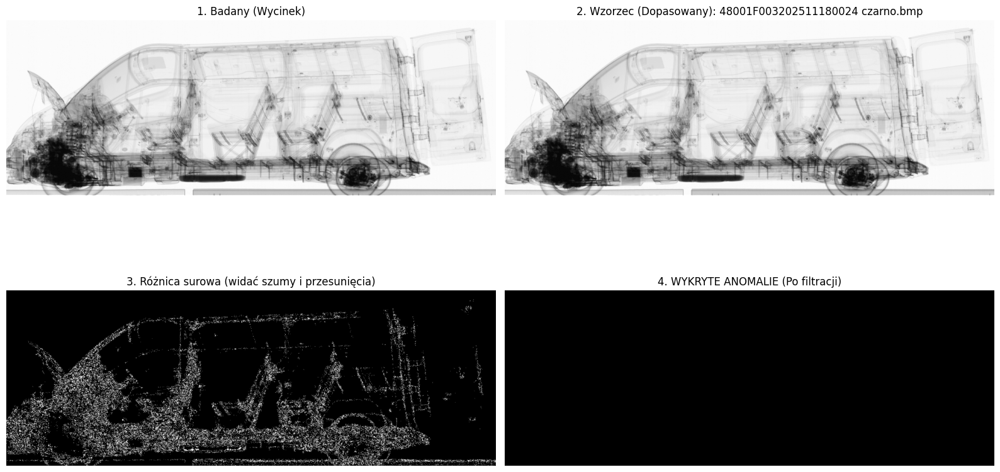

In [80]:
dirty_file = '48001F003202511180024.bmp'

clean_folder = "czyste_przeksztalcone"

find_anomaly_in_dataset(dirty_file, clean_folder)